In [1]:
import tensorflow as tf
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import scipy.io as sio
import numpy as np

import skimage.io
import sklearn.metrics
import h5py
import sys

sys.path.append("../../Data_Preprocessing/")
sys.path.append("../../Visualization/")
sys.path.append("../Metric/")

from Preprocess_Utilities import *
from Visualization import *
from Metric import *
from Data_Extractor import *

# top-left coordinate should be of shape (n, 2) => default to flatten out
def get_patches(raw_image, road_mask, topleft_coordinate, step, flatten = True):
    X = []
    Y = []
    
    if flatten:
        for coord in topleft_coordinate:
            X.append(raw_image[:, coord[0]:coord[0]+step, coord[1]:coord[1]+step].flatten())
            Y.append(road_mask[int(coord[0]+step/2), int(coord[1]+step/2)])
    else:
        for coord in topleft_coordinate:
            X.append(raw_image[:, coord[0]:coord[0]+step, coord[1]:coord[1]+step])
            Y.append(road_mask[int(coord[0]+step/2), int(coord[1]+step/2)])
        

    X = np.array(X)
    Y = np.array(Y)
    return X, Y

/home/admin-u6142160/anaconda3/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
# restore trained model & model parameter
model_name = 'motor_trunk_pri_sec_tert'
model_path = './Result/motor_trunk_pri_sec_tert/CNN - central pixel/'

sess = tf.InteractiveSession()
saver = tf.train.import_meta_graph( model_path + model_name + '.meta')
saver.restore(sess, tf.train.latest_checkpoint(model_path))

band = 7
height = 28
width  = 28

INFO:tensorflow:Restoring parameters from ./Result/motor_trunk_pri_sec_tert/CNN - central pixel/motor_trunk_pri_sec_tert


###### read in & re-construct training/test set

In [3]:
# read in & re-construct training/test set
path_raw_image = "../../Data/090085/090085_20170531.h5"
path_road_mask = "../../Data/090085/Road_Data/" + model_name + "/" + model_name + ".tif"
path_topleft_coordinate_seq = "../../Data/090085/Road_Data/" + model_name + "/topleft_coordinate_seq.h5"

raw_image = np.array(h5py.File(path_raw_image)['scene'])
road_mask = skimage.io.imread(path_road_mask)

data = h5py.File(path_topleft_coordinate_seq, 'r')
topleft_coordinate_seq = np.array(data['topleft_coordinate'])
data.close()

print(raw_image.shape, road_mask.shape)
print(raw_image.min())

(7, 7961, 8091) (7961, 8091)
-9999


In [4]:
training_info = h5py.File(model_path + 'training_info.h5')
index = training_info['Index']
norm  = training_info['Norm']

train_index = index['Train']
test_index  = index['Test']

Train_Data = Data_Extractor(raw_image, road_mask, 28,
                            pos_topleft_coord = np.array(train_index['pos']),
                            neg_topleft_coord = np.array(train_index['neg']), 
                            normalization=None)
Test_Data = Data_Extractor (raw_image, road_mask, 28,
                            pos_topleft_coord = np.array(test_index['pos']),
                            neg_topleft_coord = np.array(test_index['neg']),
                            normalization=None)

mu    = np.array(norm['mu'])
sigma = np.array(norm['sigma'])
training_info.close()

print(Train_Data.size, Test_Data.size, mu.shape, sigma.shape)

12865796 4288600 (5488,) (5488,)


In [5]:
# list all names for nodes in TFgraph
graph = tf.get_default_graph()
for op in graph.get_operations():
    print(op.name)

x
y
Placeholder
phase
W_conv1/Initializer/random_uniform/shape
W_conv1/Initializer/random_uniform/min
W_conv1/Initializer/random_uniform/max
W_conv1/Initializer/random_uniform/RandomUniform
W_conv1/Initializer/random_uniform/sub
W_conv1/Initializer/random_uniform/mul
W_conv1/Initializer/random_uniform
W_conv1
W_conv1/Assign
W_conv1/read
zeros
Variable
Variable/Assign
Variable/read
Conv2D
add
BatchNorm/beta/Initializer/zeros
BatchNorm/beta
BatchNorm/beta/Assign
BatchNorm/beta/read
BatchNorm/gamma/Initializer/ones
BatchNorm/gamma
BatchNorm/gamma/Assign
BatchNorm/gamma/read
BatchNorm/moving_mean/Initializer/zeros
BatchNorm/moving_mean
BatchNorm/moving_mean/Assign
BatchNorm/moving_mean/read
BatchNorm/moving_variance/Initializer/ones
BatchNorm/moving_variance
BatchNorm/moving_variance/Assign
BatchNorm/moving_variance/read
BatchNorm/moments/mean/reduction_indices
BatchNorm/moments/mean
BatchNorm/moments/StopGradient
BatchNorm/moments/SquaredDifference
BatchNorm/moments/variance/reduction_ind

In [6]:
# get tensor => tensor name = operation name : output index

# placeholder
x           = graph.get_tensor_by_name("x:0")
y           = graph.get_tensor_by_name("y:0")
keep_prob   = graph.get_tensor_by_name("Placeholder:0")
is_training = graph.get_tensor_by_name("phase:0")

# output
prediction = graph.get_tensor_by_name("prediction:0")
pred_prob  = graph.get_tensor_by_name("y_CNN:0")

restore prediction (pred_road)

In [4]:
# restore prediction 
h5f_pred  = h5py.File(model_path + 'CNN_prediction.h5', 'r')
pred_road = np.array(h5f_pred['pred_road'])
pred_patch_label_list = np.array(h5f_pred['pred_patch_label_list'])
h5f_pred.close()

In [7]:
# fill in valid road & true road _patch label list
valid_road = np.zeros(road_mask.shape)
true_patch_label_list = []

for coord in topleft_coordinate_seq:
    central_point = coord+int(28/2)    
    valid_road[central_point[0], central_point[1]] = road_mask[central_point[0], central_point[1]]
    true_patch_label_list.append(road_mask[central_point[0], central_point[1]])

true_patch_label_list = np.array(true_patch_label_list)
print('valid road & true_patch_label_list filled')

valid road & true_patch_label_list filled


###### calculate NEW predicted road mask

In [ ]:
# predict & plot the road mask
pred_road  = np.zeros(road_mask.shape)
valid_road = np.zeros(road_mask.shape)

# fill in image
for coord in topleft_coordinate_seq:
    img = (get_patches(raw_image, road_mask, [coord], step=28)[0] - mu) / sigma
    central_point = coord+int(28/2)
    
    pred_road[central_point[0], central_point[1]] = pred_prob.eval(
        feed_dict={x:img.reshape((-1,band,height,width)).transpose((0,2,3,1)).astype(np.float32),
                   keep_prob : 1,
                   is_training : False})
    valid_road[central_point[0], central_point[1]] = road_mask[central_point[0], central_point[1]]
    
print(pred_road.min(), pred_road.max())

In [ ]:
pred_patch_label_list = []
true_patch_label_list = []

# predict all patch
for coord in topleft_coordinate_seq:
    img = (get_patches(raw_image, road_mask, [coord], step=28)[0] - mu) / sigma
    central_point = coord+int(28/2)
    
    pred_patch_label_list.append( 
        pred_prob.eval(
            feed_dict={x:img.reshape((-1,band,height,width)).transpose((0,2,3,1)).astype(np.float32),
                       keep_prob : 1,
                       is_training : False}))
    
    true_patch_label_list.append(road_mask[central_point[0], central_point[1]])

pred_patch_label_list = np.array(pred_patch_label_list).flatten()
true_patch_label_list = np.array(true_patch_label_list)
print(pred_patch_label_list.min(), pred_patch_label_list.max())

In [ ]:
# save prediction
h5f_pred = h5py.File(model_path + 'CNN_prediction.h5', 'w')
h5f_pred.create_dataset (name='pred_road', data=pred_road)
h5f_pred.create_dataset (name='pred_patch_label_list', data=pred_patch_label_list)
h5f_pred.close()

calculate roc_curve

(array([1416717]),) [0.17505667]


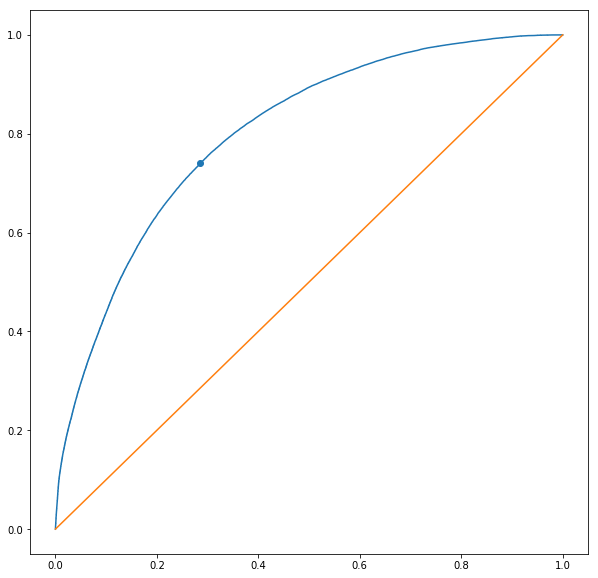

In [9]:
fpr, tpr, thresholds = sklearn.metrics.roc_curve (y_true=true_patch_label_list, y_score=pred_patch_label_list)

dist = ((fpr)**2 + (1-tpr)**2)
min_dist_idx = np.where(dist == dist.min())
print(min_dist_idx, thresholds[min_dist_idx])

plt.figure(figsize=(10,10))
plt.plot(fpr, tpr)
plt.plot([0,1])
plt.scatter(fpr[min_dist_idx], tpr[min_dist_idx])
plt.show()

In [10]:
# some basic precision & recall info corresponding to the best point on roc_curve
sklearn.metrics.precision_recall_fscore_support(y_true=true_patch_label_list,
                                                y_pred=(pred_patch_label_list>thresholds[min_dist_idx]).astype(int))

(array([0.99859169, 0.00995504]),
 array([0.71433425, 0.74034299]),
 array([0.83287693, 0.01964591]),
 array([17088097,    66299]))

Plot probability pred_road & true road mask

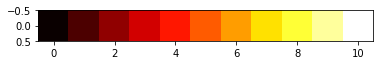

In [11]:
plt.imshow(np.array([[0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1]]), cmap='hot')
plt.show()
plt.figure(figsize=(150,150))
plt.imshow(pred_road, cmap=plt.get_cmap('hot'))
plt.show()

In [5]:
print(pred_road.min(), pred_road.max(), pred_road.mean())

0.0 0.9079922437667847 0.03652149546211624


In [ ]:
plt.figure(figsize=(150,150))
plt.imshow(valid_road, cmap=plt.get_cmap('gray'))
plt.show()

In [ ]:
print ('Roads in training/test set')
plt.figure(figsize=(50,50))
plt.imshow(valid_road, cmap=plt.get_cmap('gray'))
plt.show()

print('All roads')
plt.figure(figsize=(50,50))
plt.imshow(road_mask, cmap=plt.get_cmap('gray'))
plt.show()

print ('Roads outside training/test set')
plt.figure(figsize=(50,50))
plt.imshow(road_mask-valid_road, cmap=plt.get_cmap('gray'))
plt.show()

Plot -log probability pred_road

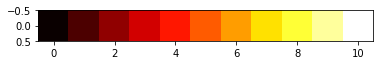

In [12]:
log_pred = -np.log(-pred_road + 1)

plt.imshow(np.array([[0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1]]), cmap='hot')
plt.show()
plt.figure(figsize=(150,150))
plt.imshow(log_pred, cmap='hot')
plt.show()

Plot pred_road with raw image on background

In [22]:
show_pred_prob_with_raw(raw_image, pred_road, true_road=road_mask, pred_weight=0.5, figsize=(150,150),
                        show_plot=False,
                        save_path=model_path + 'Analysis/prob_pred_on_raw - 0.5.png')

In [24]:
show_pred_prob_with_raw(raw_image, (log_pred - log_pred.min()) / (log_pred.max()-log_pred.min()),
                        true_road=road_mask, pred_weight=0.5, figsize=(150,150), show_plot=False,
                        save_path=model_path + 'Analysis/log_prob_on_raw - 0.5.png')

In [18]:
(log_pred - log_pred.min()) / (log_pred.max()-log_pred.min)

2.385882398603947

In [13]:
def show_pred_prob_with_raw(image, road_prob, true_road=None, light=3.0, pred_weight=0.3,
                            figsize=(20,20), show_plot=True, save_path=None):

    sub_image = image[[1,2,3]]

    assert (road_prob >= 0).all() and (road_prob <= 1).all()
    sub_image = sub_image/10000*light        
    
    for img in sub_image:
        img[np.where(img<0)] = 0
        img[np.where(img>1)] = 1
    
    # add into R channel
    sub_image[2] = sub_image[2] + road_prob*pred_weight
    sub_image[2][np.where(sub_image[2]>1)] = 1
    
    # strenthen the B channel of true roads
    if not (true_road is None):
        true_road_index = np.where(true_road == 1)
        sub_image[0][true_road_index] = 1
        
    patch = np.array([sub_image[2].T, sub_image[1].T, sub_image[0].T]).T
    plt.figure(figsize=figsize)
    plt.imshow(patch)
    if not save_path is None:
        plt.savefig(save_path, bbox_inches='tight')
    if show_plot:
        plt.show()
        plt.clf()
    plt.close()

In [ ]:
plt.close('all')
show_pred_prob_with_raw(raw_image, pred_road, x = 0,y = 0, light=3.0, size=-1, figsize=(50,50),
                        show_plot = False, show_raw=False, threshold = thresholds[min_dist_idx],)

In [ ]:
plt.close('all')
show_image_against_road(raw_image, pred_road, x = 0,y = 0, light=3.0, size=-1, figsize=(150,150),
                        show_plot = False, show_raw=False, threshold = thresholds[min_dist_idx], 
                        save_path = model_path + 'Analysis/CNN-pred_road on raw - TH=ROC_point.png')

In [ ]:
plt.close('all')
show_image_against_road(raw_image, pred_road, x = 0,y = 0, light=3.0, size=-1, figsize=(150,150),
                        show_plot = False, show_raw=False, threshold = 0.4, 
                        save_path = model_path + 'Analysis/CNN-pred_road on raw - TH=0_4.png')

In [ ]:
plt.close('all')
show_image_against_road(raw_image, pred_road, x = 0,y = 0, light=1.5, size=-1, figsize=(150,150),
                        show_plot = False, show_raw=False, threshold = 0.4, 
                        save_path = model_path + 'Analysis/CNN-pred_road on raw - 1.5 - TH=0_4.png')

In [ ]:
plt.close('all')
show_pred_road_against_raw(raw_image, pred_road, true_road=valid_road, figsize=(150,150), 
                           show_plot=False, show_raw=False, threshold = 0.5, 
                           save_path=model_path + 'Analysis/CNN-pred_road with true road - TH=0_5.png')

In [ ]:
plt.close('all')
show_pred_road_against_raw(raw_image, pred_road, true_road=valid_road, figsize=(150,150), 
                           show_plot=False, show_raw=False, threshold = thresholds[min_dist_idx], 
                           save_path=model_path + 'Analysis/CNN-pred_road with true road - TH=ROC_point.png')

In [ ]:
# predict training & test set

# training set
train_metric = Metric(record_index=True)

batch_size = 64light
batch_num = int(train_index.size/batch_size)+1
for i in range(batch_num):
    staXrt = i%batch_num * batch_size
    end = start + batch_size

    if end > train_index.size:
        end = train_index.size
    
    index = train_index[start:end]
    batch_x, batch_y = get_patches(raw_image, road_mask, topleft_coordinate[index], step=28)
    batch = [((batch_x-mu)/sigma), np.matrix(batch_y & training info into session).astype(int).T]
    
    # record metric
    pred = prediction.eval(feed_dict={x:batch[0]})
    train_metric.accumulate(pred, batch[1])
    train_pred_label[start:end] = pred.T
    
print("Training Result:")
train_metric.print_info()
print()
pred_road = np.zeros(road_mask.shape)
for coord, img in top:

    

# test set3.0
test_metric = Metric(record_index=True)

batch_size = 64
batch_num = int(test_index.size/batch_size)+1
for i in range(batch_num):
    start = i%batch_num * batch_size
    end = start + batch_size

    if end > test_index.size:
        end = test_index.size
    
    index = test_index[start:end]
    batch_x, batch_y = get_patches(raw_image, road_mask, topleft_coordinate[index], step=28)
    batch = [((batch_x-mu)/sigma), np.matrix(batch_y).astype(int).T]

    # record metric   
    pred = prediction.eval(feed_dict={x:batch[0]})
    test_metric.accumulate(pred, batch[1])
    test_pred_label[start:end] = pred.T

print("Test Result:")
test_metric.print_info()

In [ ]:
# band img - average over TP/FP/TN/FN (train set)
band_num = 7
plt.close('all')

fig, subfig = plt.subplots(nrows=band_num, ncols=4, sharex=True, sharey=True, figsize=(100,20*band_num))    
for img_col, idx_label in zip(range(4), ['TP', 'FP', 'TN', 'FN']):
    img_idx = train_index[train_metric.get_index(idx_label)]  
    if idx_label == 'TN':
        band_img = 0.0
        for idx in img_idx:
            band_img += get_patches(raw_image,road_mask,[topleft_coordinate[idx]],step=28)[0]
        band_img = band_img.mean(axis=0).reshape((7,28,28))
            
        for band_idx in range(band_num): 
            subfig[band_idx,img_col].imshow(band_img[band_idx], cmap=plt.get_cmap('gray'))

    else:
        band_img = get_patches(raw_image,road_mask,topleft_coordinate[img_idx], step=28)[0]
        band_img = band_img.mean(axis=0).reshape((7,28,28))

        for band_idx in range(band_num): 
            subfig[band_idx,img_col].imshow(band_img[band_idx], cmap=plt.get_cmap('gray'))

plt.savefig(model_path + 'Analysis/Band - avg on TP_FP_TN_FN.png')
plt.show()

In [ ]:
# band info - TP/FP/TN/FN on training set
band_num = 7
plt.close('all')
for band_idx in range(band_num):

    band_mu    = (mu.reshape((7,28,28)))[band_idx, :, :].flatten()
    band_sigma = (sigma.reshape((7,28,28)))[band_idx, :, :].flatten()
    
    plt.figure(figsize=(15,5))
    plt.axvline(0)
    
    for idx_name in ['TP', 'FP', 'FN']:
        
        band_norm = []
        for idx in train_metric.get_index(idx_name):
            band_norm.extend(
                (get_patches(raw_image, road_mask, [topleft_coordinate[idx]],
                             step=28, flatten=False)[0][0,band_idx].flatten()-band_mu)/band_sigma)
    
        band_norm = np.array(band_norm)
        plt.xticks(np.linspace(band_norm.min(),band_norm.max(), 20))
        plt.hist(band_norm, bins=300, histtype='step', label=idx_name)

    plt.legend()
    plt.savefig(model_path + 'Analysis/Band - info TP_FP_TN_FN/band ' + str(band_idx))
    plt.show()

    print("===================================================================================")

In [ ]:
# false pos
for i in range(10):
    idx = np.random.randint(0, len(false_pos_idx))
    idx = false_pos_idx[idx]
    print(idx)
    
    img  = X[idx].reshape(7, 28, 28)
    road = Road_patch[idx]
    show_image_against_road(img, road, size = -1, figsize=None, show_raw=False)
    for band in range(7):
        plt.imshow(img[band, :, :], cmap=plt.get_cmap('gray'))
        plt.show()
    break

In [ ]:
# true pos
for i in range(10):
    idx = np.random.randint(0, len(true_pos_idx))
    idx = true_pos_idx[idx]
    print(idx)
    
    img  = X[idx].reshape(7, 28, 28)
    road = Road_patch[idx]
    show_image_against_road(img, road, size = -1, figsize=None,show_raw=True)
    for band in range(7):
        plt.imshow(img[band, :, :], cmap=plt.get_cmap('gray'))
        plt.show()
    break

In [ ]:
# band info - whole dataset
band_num = 7
for band_idx, band_color in zip(range(band_num), reversed(cm.rainbow(np.linspace(0, 1, band_num)))):
    band       = X[:,band_idx,:,:]
    band_mu    = (mu.reshape((7,28,28)))[band_idx, :, :].flatten()
    band_sigma = (sigma.reshape((7,28,28)))[band_idx, :, :].flatten()

    band_norm = (band.reshape((band.shape[0], -1))-band_mu)/band_sigma
    print(band.shape, band_mu.shape, band_norm.shape)
    
    plt.figure(figsize=(20,7))
    plt.xticks(np.linspace(band_norm.min(),band_norm.max(), 20))
    plt.hist(band_norm.flatten(), bins=300, color=band_color, histtype='step')
    plt.axvline(0)
    plt.show()